In [3]:
from studydata import NerrStudyData
import seaborn as sns
# import folium
# from folium.plugins import MarkerCluster
# from folium import IFrame
import ipywidgets as widgets
# from pandas_profiling import ProfileReport
import pandas as pd
import numpy as np
from jupyter_dashboard import StudyMap
import matplotlib.pyplot as plt

%matplotlib inline

# plt.rcParams["figure.figsize"]=20,20

rc={'figure.figsize':(20,20)}
sns.set(rc=rc)

In [4]:
nerr = NerrStudyData(online_source=False)

In [5]:
wq_df = nerr.get_wq_data()
nut_df = nerr.get_nut_data()
met_df = nerr.get_met_data()
stations_df = nerr.get_stations()

In [4]:
# https://towardsdatascience.com/interactive-controls-for-jupyter-notebooks-f5c94829aee6
    
ALL = "All"
def create_dropdown(options_list, include_all=False, *args, **kwargs):
    options_list.sort()
    if include_all:
        options_list.insert(0, ALL)

    dropdown = widgets.Dropdown(
        options=options_list,
        *args,
        **kwargs
    )
    return dropdown

def create_validation_dropdown(include_all=True):
    options = ["Historical", "ProvisionalPlus"]
    kwargs = dict(
        value=ALL,
        description= "Validation:"
    )
    dropdown = create_dropdown(options, include_all=True, **kwargs)
    return dropdown

def create_corr_dropdown():
    corr_methods = ["pearson", "kendall", "spearman"]
    kwargs = dict(
        value="pearson",
        description= "Correlation Method:"
    )    
    dropdown = create_dropdown(corr_methods, **kwargs)
    return dropdown

# Station code dropdown
def create_stations_dropdown(options, include_all=False):
    kwargs = dict(
        description= "Station Code:"
    )
    dropdown = create_dropdown(options, include_all, **kwargs)    
    return dropdown

# Filter by station_code...
def filter_by_station_code(df, station_code):
    if station_code == ALL:
        return df
    else:
        mask = (df["StationCode"] == station_code)
        df = df.loc[mask]            
    return df

# Filter by validation_code...
def filter_by_validation_code(df, validation_code):
    if validation_code == ALL:
        return df
    elif validation_code == "Historical":
        mask = (df["Historical"] == "1")
    elif validation_code == "ProvisionalPlus":
        mask = (df["ProvisionalPlus"] == "1")
    return df.loc[mask]

def display_summary_widget(df, locations_df, include_all=False):

    options = df.StationCode.unique().tolist()
    stations_dropdown = create_stations_dropdown(options, include_all)
    validation_dropdown = create_validation_dropdown()

    def on_dropdown_update(df, locations_df, station_code, validation_code):
        # Filter by validation code
        df = filter_by_station_code(df, station_code)
        # Filter by station code
        df = filter_by_validation_code(df, validation_code) 
      
        # Filter locations_df by station code
        locations_df = filter_by_station_code(locations_df, station_code)
        study_map = StudyMap.create_stations_map(locations_df)

        display(study_map)
        if not df.empty:            
            msg = f"Summary for {station_code}: {validation_code}"
            display(widgets.HTML(msg))
            display(df.groupby("StationCode").describe().stack())
        else:
            msg = "No data was found with the selected filters. {station_code}: {validation_code}"
            msg += "Unable to generate report."
            display(widgets.HTML(msg))            

    widgets.interact(
        on_dropdown_update,
        df=widgets.fixed(df),
        locations_df=widgets.fixed(locations_df),
        station_code=stations_dropdown,
        validation_code=validation_dropdown
    )

In [6]:
study_map = StudyMap.create_stations_map(stations_df)
display(study_map)
display(stations_df)

Map(center=[17.95524, -66.22], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zo…

,StationCode,StationName,Latitude,Longitude,Status,ActiveDates,State,ReserveName,GMTOffset,StationType,geometry
137,job06wq,Station 6,17.934986,-66.227933,Inactive,Dec 1996-Dec 1998,pr,Jobos Bay,-4,Water Quality,POINT (-66.22793 17.93499)
138,job09nut,Station 9,17.943056,-66.238583,Active,Jul 2002-,pr,Jobos Bay,-4,Nutrients,POINT (-66.23858 17.94306)
139,job09wq,Station 9,17.943056,-66.238583,Active,Dec 1995-,pr,Jobos Bay,-4,Water Quality,POINT (-66.23858 17.94306)
140,job10nut,Station 10,17.938611,-66.257736,Active,Jul 2002-,pr,Jobos Bay,-4,Nutrients,POINT (-66.25774 17.93861)
141,job10wq,Station 10,17.938611,-66.257736,Active,Feb 1996-,pr,Jobos Bay,-4,Water Quality,POINT (-66.25774 17.93861)
142,job11wq,Station 11,17.944608,-66.262028,Inactive,Mar 1996-Dec 1998,pr,Jobos Bay,-4,Water Quality,POINT (-66.26203 17.94461)
143,job18wq,Station 18,17.944433,-66.231881,Inactive,Oct 1998- Nov 1998,pr,Jobos Bay,-4,Water Quality,POINT (-66.23188 17.94443)
144,job19nut,Station 19,17.942914,-66.228825,Active,Jul 2002-,pr,Jobos Bay,-4,Nutrients,POINT (-66.22883 17.94291)
145,job19wq,Station 19,17.942914,-66.228825,Active,Apr 2002-,pr,Jobos Bay,-4,Water Quality,POINT (-66.22883 17.94291)
146,job20nut,Station 20,17.930317,-66.211472,Active,Jul 2002-,pr,Jobos Bay,-4,Nutrients,POINT (-66.21147 17.93032)


<AxesSubplot:>

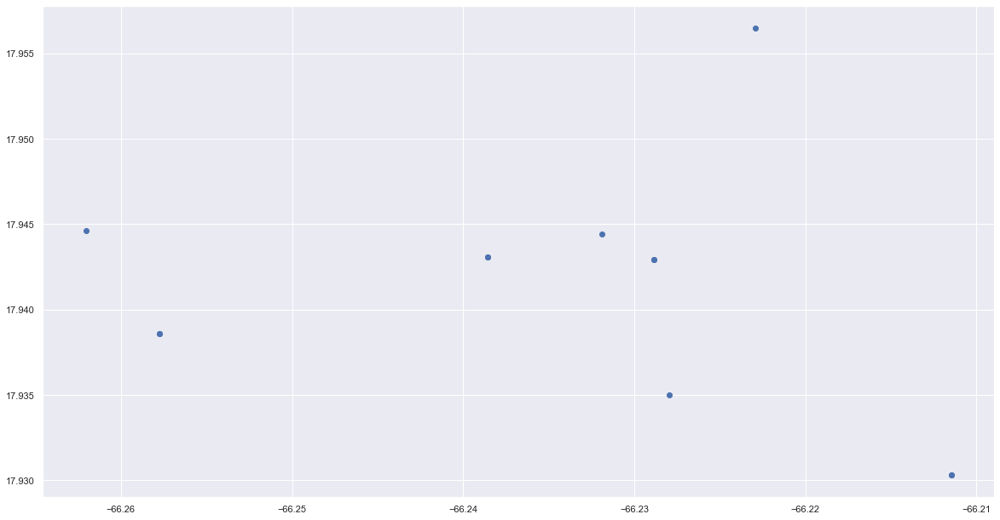

In [12]:
stations_df.plot()

## In the summary may want to melt those describe columns and include a tab to show station metadata...

## EDA for Nutrients dataset filtered by station code and quality flag

In [6]:
display_summary_widget(nut_df.sort_values(["StationCode", "DateTimeStamp"]), stations_df, include_all=True)

interactive(children=(Dropdown(description='Station Code:', options=('All', 'job09nut', 'job10nut', 'job19nut'…

## EDA for Water Quality dataset filtered by station code and quality flag

In [7]:
display_summary_widget(wq_df.sort_values(["StationCode", "DateTimeStamp"]), stations_df, include_all=True)

interactive(children=(Dropdown(description='Station Code:', options=('All', 'job06wq', 'job09wq', 'job10wq', '…

## EDA for Meteorological dataset filtered by station code and quality flag

In [8]:
display_summary_widget(met_df.sort_values(["StationCode", "DateTimeStamp"]), stations_df, include_all=True)

interactive(children=(Dropdown(description='Station Code:', options=('All', 'jobjbmet'), value='All'), Dropdow…

In [10]:
# Accepts args and kwargs for df.corr
def create_corr_matrix(df, method, *args, **kwargs):
    corr_df = df.corr(
        method,
        *args,
        **kwargs
    )
    return corr_df

# Accepts args and kwargs for sns.heatmap
def create_heatmap(df, *args, **kwargs): 
    ax = sns.heatmap(
        df,
        *args,
        **kwargs
    )
    return ax

# Given a df, returns correlation df and heatmap ax
def create_corr_heatmap(df, method="pearson"):
    corr_df = create_corr_matrix(df, method, min_periods=1)
    
    heatmap_options = dict(
        annot=True,
        fmt='.1g',
        vmin=-1,
        vmax=1,
        center= 0,
        cmap= 'RdBu',
        square=True        
    )
    ax = create_heatmap(corr_df, **heatmap_options)
    return (corr_df, ax)

def display_correlation_widget(df, include_all=False):
    options = df.StationCode.unique().tolist()
    stations_dropdown = create_stations_dropdown(options, include_all)

    corr_method_dropdown = create_corr_dropdown()
    validation_dropdown = create_validation_dropdown()

    def on_dropdown_update(df, station_code, validation_code, corr_method):
        df = filter_by_station_code(df, station_code)
        df = filter_by_validation_code(df, validation_code)         
        
        if not df.empty:
            msg = f"Generating {corr_method} correlation plot for {station_code}: {validation_code}"
            display(widgets.HTML(msg))
            create_corr_heatmap(df, method=corr_method)
        else:
            msg = "No data was found with the selected filters."
            msg += "Unable to generate report."
            display(widgets.HTML(msg))

    widgets.interact(
        on_dropdown_update,
        df=widgets.fixed(df),
        station_code=stations_dropdown,
        validation_code=validation_dropdown,        
        corr_method=corr_method_dropdown
    )

display_correlation_widget(nut_df, include_all=True)

interactive(children=(Dropdown(description='Station Code:', options=('All', 'job09nut', 'job10nut', 'job19nut'…

In [11]:
# Accepts args and kwargs for sns.heatmap
def create_pairplot(df, *args, **kwargs): 
    ax = sns.pairplot(
        df,
        *args,
        **kwargs
    )
    return ax

# Given a df, returns correlation df and heatmap ax
def create_dist_pairplot(df):
    var_cols = nut_df.select_dtypes("float").columns.tolist()
    pairplot_options = dict(
        vars=var_cols,
        hue="StationCode"
    )
    ax = create_pairplot(df, **pairplot_options)
    return ax

def display_distribution_widget(df, include_all=False):
    options = df.StationCode.unique().tolist()
    stations_dropdown = create_stations_dropdown(options, include_all)

    validation_dropdown = create_validation_dropdown()

    def on_dropdown_update(df, station_code, validation_code):   
        df = filter_by_station_code(df, station_code)
        df = filter_by_validation_code(df, validation_code)         
        
        if not df.empty:
            msg = f"Generating pairplot for {station_code}: {validation_code}"
            display(widgets.HTML(msg))
            create_dist_pairplot(df)
        else:
            msg = "No data was found with the selected filters."
            msg += "Unable to generate report."
            display(widgets.HTML(msg))

    widgets.interact(
        on_dropdown_update,
        df=widgets.fixed(df),
        station_code=stations_dropdown,
        validation_code=validation_dropdown
    )


display_distribution_widget(nut_df, include_all=True)

interactive(children=(Dropdown(description='Station Code:', options=('All', 'job09nut', 'job10nut', 'job19nut'…

In [16]:
# Accepts args and kwargs for sns.heatmap
def create_lineplot(df, *args, **kwargs): 
    ax = sns.lineplot(
        data=df,
        *args,
        **kwargs
    )
    return ax

def display_lineplot_widget(df, include_all=False):
    options = df.StationCode.unique().tolist()
    stations_dropdown = create_stations_dropdown(options, include_all)

    validation_dropdown = create_validation_dropdown()

    def on_dropdown_update(df, station_code, validation_code):   
        df = filter_by_station_code(df, station_code)
        df = filter_by_validation_code(df, validation_code)         
        
        if not df.empty:
            msg = f"Generating lineplot for {station_code}: {validation_code}"
            display(widgets.HTML(msg))
            create_lineplot(
                df,
                x="DateTimeStamp",
                y="PO4F",
                hue="StationCode"
            )
        else:
            msg = "No data was found with the selected filters."
            msg += "Unable to generate report."
            display(widgets.HTML(msg))

    widgets.interact(
        on_dropdown_update,
        df=widgets.fixed(df),
        station_code=stations_dropdown,
        validation_code=validation_dropdown
    )


display_lineplot_widget(nut_df, include_all=False)

interactive(children=(Dropdown(description='Station Code:', options=('All', 'job09nut', 'job10nut', 'job19nut'…

In [11]:
# https://python-forum.io/Thread-Visualisation-of-gaps-in-time-series-data

def resample_reindex_by_freq(df, freq="1M"):
    min_date = df.DateTimeStamp.min().date()
    max_date = df.DateTimeStamp.max().date()

    grouper_list = [
        pd.Grouper(key="StationCode"), pd.Grouper(key="DateTimeStamp", freq=freq)
    ]
    df = df.groupby(grouper_list).mean().sort_index()

    idx = pd.date_range(min_date, max_date, freq=freq, name="DateTimeStamp")
    mdx = pd.MultiIndex.from_product([df.index.get_level_values(0).unique(), idx])
    df = df.reindex(mdx)
    return df

# Accepts args and kwargs for sns.heatmap
def create_heatmap(df, *args, **kwargs): 
    ax = sns.heatmap(
        data=df,
        *args,
        **kwargs
    )
    return ax

def create_missing_val_heatmap(df):
    kwargs = dict(
        cbar=True,
        cmap="Greys"
    )
    ax = create_heatmap(df, **kwargs)
    return ax

def create_freq_dropdown():
    options = ["None", "1D", "1M", "1Y"]
    kwargs = dict(
        value="None",
        description="Frequency:"
    )
    dropdown = create_dropdown(options, **kwargs)
    return dropdown

def display_missing_val_widget(df, include_all=False):
    options = df.StationCode.unique().tolist()
    stations_dropdown = create_stations_dropdown(options, include_all)

    validation_dropdown = create_validation_dropdown()
    frequency_dropdown = create_freq_dropdown()
    
    def on_dropdown_update(df, station_code, validation_code, frequency_code):   
        df = filter_by_station_code(df, station_code)
        df = filter_by_validation_code(df, validation_code)
        
        if not df.empty:
            msg = f"Generating missing values heatmap for {station_code}: {validation_code}"
            if frequency_code != "None":
                df = resample_reindex_by_freq(df, frequency_code)
            else:
                df = df.set_index(["StationCode", "DateTimeStamp"])
            
            display(widgets.HTML(msg))
            create_missing_val_heatmap(
                df.notnull()
            )
        else:
            msg = "No data was found with the selected filters."
            msg += "Unable to generate report."
            display(widgets.HTML(msg))

    widgets.interact(
        on_dropdown_update,
        df=widgets.fixed(df),
        station_code=stations_dropdown,
        validation_code=validation_dropdown,
        frequency_code=frequency_dropdown
    )
        
df = nut_df.copy()
stations = nut_df.StationCode.unique().tolist()
mask = (df.StationCode == stations[0])
display_missing_val_widget(df)

interactive(children=(Dropdown(description='Station Code:', options=('job09nut', 'job10nut', 'job19nut', 'job2…